# Теоретическая справка: Решающие деревья и случайный лес

## Цель работы
Целью работы является изучение и сравнение двух распространённых алгоритмов машинного обучения — **деревьев решений (Decision Tree, DT)** и **случайного леса (Random Forest, RF)** — и их применение для классификации или регрессии на выбранных данных. Основная задача — построить модели, оптимизировать их гиперпараметры и оценить качество предсказаний.

## Задачи работы
- Ознакомиться с теорией и принципами работы алгоритмов DT и RF.
- Подготовить и обработать данные для обучения моделей.
- Обучить модели с использованием деревьев решений и случайного леса.
- Применить методы оптимизации гиперпараметров (Optuna, GridSearch).
- Построить визуализации моделей (tree_plot).
- Сравнить результаты моделей, выявить влияние оптимизации.

После выполнения работы для классификации я перечитал задание и решил выполнить ещё для регрессии.

# Классификация

## Описание алгоритмов

### Дерево решений (Decision Tree)
Дерево решений — иерархическая структура, где каждая вершина соответствует проверке значения одного признака, а листья — итоговому решению (классу или числовому предсказанию). Обучение происходит путём рекурсивного разбиения данных на подмножества по признакам с целью максимально повысить однородность полученных групп.

Более подробно можно ознакомиться [здесь](https://drive.google.com/file/d/1eTpJng1b2hEFMfJ0PbURdpSV0urQx4FT/view?usp=sharing)

#### Краткая справка по параметрам DecisionTreeClassifier
``criterion`` — Функция для оценки качества разбиения, поддерживаются “gini”, “entropy” и “log_loss”.  
``splitter`` — Стратегия выбора разбиения в каждом узле: “best” выбирает лучшее, “random” — случайное лучшее.  
``max_depth`` — Максимальная глубина дерева; если None, разветвление продолжается пока листья не станут чистыми или не меньше min_samples_split.  
``min_samples_split`` — Минимальное число образцов, необходимое для разбиения внутреннего узла; если float, то это доля от общего числа.  
``min_samples_leaf`` — Минимальное число образцов в листовом узле; при float — доля от общего числа, обеспечивает сглаживание модели.  
``min_weight_fraction_leaf`` — Минимальная взвешенная доля суммы весов всех образцов, необходимая для листового узла.  
``max_features`` — Количество признаков, рассматриваемых для выбора лучшего разбиения; может быть int, float (доля), “sqrt”, “log2” или None.  
``random_state`` — Управляет случайностью оценщика для повторяемости результатов, принимает int, RandomState или None.  
``max_leaf_nodes`` — Максимальное число листовых узлов; если None, число неограничено, узлы выбираются по максимальному уменьшению нечистоты.  
``min_impurity_decrease`` — Минимальное уменьшение нечистоты, необходимое для разделения узла;
``class_weight`` — Веса классов в формате словаря {метка_класса: вес} или “balanced” для автоматической балансировки по частоте классов.  
``ccp_alpha`` — Параметр сложности для минимальной стоимости сложностного обрезания (прюнинга); если 0.0, прюнинг не выполняется.  

### Случайный лес (Random Forest)
Случайный лес — ансамблевый метод, который строит множество независимых решающих деревьев на случайных подвыборках обучающих данных с использованием случайных подмножеств признаков для каждого дерева. Итоговое решение принимается большинством голосов деревьев (в классификации) или усреднением (в регрессии).
Алгоритм случайного леса работает следующим образом:

1. Для каждого $n = 1, \ldots, N$ создаётся новая обучающая выборка $\hat{X}_n$ методом бутстрэпа — случайного выбора объектов из исходного набора с возвращением.

2. По этой выборке строится решающее дерево $b_n(x)$, которое растёт до тех пор, пока в каждом листе не будет не более $n_{min}$ объектов.

3. При каждом разбиении в узле случайно выбирается подмножество из $m$ признаков из всех $p$, и оптимальное разделение ищется только среди этих выбранных признаков.

4. Итоговое решение — композиция из всех деревьев, которая получается усреднением их ответов:

$$
a_N(x) = \frac{1}{N} \sum_{n=1}^N b_n(x)
$$

В случайном лесу признак для разбиения выбирается из случайного набора признаков размером $m$.

Рекомендации для выбора $m$: 
- В задачах классификации обычно $m = \sqrt{p}$
- В задачах регрессии — примерно $m = \frac{p}{3}$

Такой подход позволяет повысить устойчивость модели и уменьшить переобучение, за счет разнообразия деревьев, обученных на разных выборках и с разными признаками.


#### Кратка справка по параметрам RandomForestClassifier
``n_estimators`` — Количество деревьев в лесу, по умолчанию 100.  
``criterion`` — Функция оценки качества разбиения дерева: “gini”, “entropy” или “log_loss”.  
``max_depth`` — Максимальная глубина дерева, если None, разветвление продолжается пока листья чистые или меньше min_samples_split.  
``min_samples_split`` — Минимальное количество образцов для разбиения узла, int или доля от общего числа.  
``min_samples_leaf`` — Минимальное количество образцов в листовом узле, int или доля, помогает сглаживать модель.  
``min_weight_fraction_leaf`` — Минимальная взвешенная доля веса образцов, необходимая на листовом узле.  
``max_features`` — Количество признаков для поиска лучшего разбиения, может быть int, float, “sqrt”, “log2” или None; по умолчанию “sqrt”    
``max_leaf_nodes`` — Максимальное число листовых узлов, выбираемых по максимальному снижению нечистоты; None значит без ограничений.  
``min_impurity_decrease`` — Минимальное снижение нечистоты, чтобы выполнить разбиение узла;  
``bootstrap`` — Использовать ли бутстрэп-выборки для построения деревьев, по умолчанию True.  
``oob_score`` — Использовать ли образцы “out-of-bag” для оценки качества модели; только при bootstrap=True.  
``n_jobs`` — Количество параллельных процессов для выполнения fit, predict и др.; None=1, -1=все процессоры.  
``random_state`` — Контролирует случайность бутстрэппинга и выбора признаков для разбиений.  
``verbose`` — Уровень вывода информации при обучении и прогнозировании, по умолчанию 0.  
``warm_start`` — При True переиспользует предыдущую модель и добавляет деревья, иначе строит заново.  
``class_weight`` — Веса классов в формате словаря или “balanced”, автоматически регулирует веса по частоте.  
``ccp_alpha`` — Коэффициент сложности для минимальной стоимости сложностного обрезания (прюнинга); по умолчанию 0.0.  
``max_samples`` — Если bootstrap=True, число выборок для обучения каждого базового оценщика; int, float или None.  
``monotonic_cst`` — Массив ограничений монотонности для признаков: 1 — возрастание, 0 — без ограничений, -1 — убывание; не поддерживается для многоклассовых и данных с пропусками.  



In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import pandas as pd
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import optuna
optuna.logging.set_verbosity(optuna.logging.CRITICAL)


### Data Processing
скопируем из ДЗ2

In [2]:
df = pd.read_csv('data/df_after_hw_1.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19066 entries, 0 to 19065
Data columns (total 46 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   brand                         19066 non-null  object 
 1   model                         19066 non-null  object 
 2   year                          19066 non-null  float64
 3   mileage                       19066 non-null  float64
 4   engine                        19066 non-null  object 
 5   engine_size                   19066 non-null  float64
 6   transmission                  19066 non-null  object 
 7   automatic_transmission        19066 non-null  bool   
 8   fuel_type                     19066 non-null  int64  
 9   min_mpg                       19066 non-null  float64
 10  max_mpg                       19066 non-null  float64
 11  damaged                       19066 non-null  bool   
 12  first_owner                   19066 non-null  bool   
 13  p

In [3]:
bins = [-float('inf'), 10000, 25000, 50000, 100000, float('inf')]
labels_y = ['low', 'mid-', 'mid', 'mid+', 'high']
df['price_category'] = pd.cut(df['price'], bins=bins, labels=labels_y, right=False).astype('category')
data_new = df.drop(columns=['personal_using', 'automatic_emergency_braking', 'drivetrain_Unknown', 'brand', 'model', 'engine', 'transmission', 'interior_color', 'exterior_color', 'min_mpg', 'max_mpg', 'price'])
mapping_y = {label: idx - 2 for idx, label in enumerate(labels_y)}
data_new['price_category'] = data_new['price_category'].map(mapping_y)

X = data_new.drop(columns=['price_category'])
y = data_new['price_category']
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.1/0.8, random_state=42)
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

columns_to_scale = ['year', 'mileage', 'engine_size', 'avg_mpg',
                    'brand_freq', 'model_freq', 'engine_freq', 'transmission_freq',
                    'interior_color_freq', 'exterior_color_freq']

scaler = StandardScaler()
X_train[columns_to_scale] = scaler.fit_transform(X_train[columns_to_scale])
X_test[columns_to_scale] = scaler.transform(X_test[columns_to_scale])
X_train

,year,mileage,engine_size,automatic_transmission,fuel_type,damaged,first_owner,turbo,alloy_wheels,adaptive_cruise_control,...,brand_freq,model_freq,engine_freq,transmission_freq,interior_color_freq,exterior_color_freq,drivetrain_Four-wheel Drive,drivetrain_Front-wheel Drive,drivetrain_Rear-wheel Drive,avg_mpg
6610,0.453054,-0.205385,-0.721192,True,5,False,True,True,True,True,...,-0.573261,-0.225248,-0.558232,0.208364,-0.933212,-0.486926,True,False,False,-0.273455
6606,0.863384,-1.167348,-0.721192,True,5,False,False,True,True,False,...,0.280332,1.256548,2.575786,-1.038874,1.153829,-0.573113,True,False,False,-0.729397
17195,-0.777936,-0.283911,-0.721192,False,5,True,False,True,True,False,...,-0.121359,0.367470,-0.580469,-1.267329,1.153829,0.563623,True,False,False,-0.820586
16205,-0.777936,-0.878428,1.184862,True,5,False,False,False,False,False,...,-0.908004,-0.719180,-0.648569,-1.285852,-0.938617,-0.575442,False,False,True,-0.328720
8665,0.453054,-0.605844,0.107527,True,5,False,True,True,True,False,...,-0.037673,-0.356964,-0.169086,1.376877,-0.941191,-0.594077,True,False,False,-0.638209
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16580,0.453054,-0.746533,0.107527,True,2,False,False,True,True,True,...,-0.037673,-0.356964,-0.584638,1.376877,-0.880966,-0.484596,True,False,False,-1.094152
7373,0.453054,-0.531468,-0.306833,True,5,False,True,False,True,True,...,-0.138096,-0.488679,-0.094036,0.208364,1.153829,-0.309893,True,False,False,0.638431
7407,-0.983101,0.978350,-1.218424,False,5,False,False,True,True,False,...,0.280332,-0.389892,-0.269152,-1.267329,1.153829,-0.559136,False,True,False,1.185563
7487,0.658219,-0.390700,-0.721192,True,5,False,False,True,True,True,...,0.196647,-0.324035,2.575786,-1.063058,-0.777502,-0.312223,True,False,False,0.364866


### Decision Tree Classifier

In [4]:
dtc = DecisionTreeClassifier(random_state=42, class_weight='balanced')
dtc.fit(X_train, y_train)
dtc_y_pred = dtc.predict(X_test)
dtc_acc = accuracy_score(y_test, dtc_y_pred) * 100
dtc_f1_macro = f1_score(y_test, dtc_y_pred, average='macro') * 100
dtc_f1_weighted = f1_score(y_test, dtc_y_pred, average='weighted') * 100
dtc_per_class = f1_score(y_test, dtc_y_pred, average=None) * 100


print(f"Accuracy: {dtc_acc:.2f}%")
print(f"F1-macro: {dtc_f1_macro:.2f}%")
print(f"F1-weighted: {dtc_f1_weighted:.2f}%")
print("F1 per class (%):", dtc_per_class)

Accuracy: 75.12%
F1-macro: 66.88%
F1-weighted: 75.04%
F1 per class (%): [55.8974359  74.86631016 80.87100331 67.1679198  55.62130178]


In [5]:
def objective(trial: optuna.Trial):
    max_depth = trial.suggest_int('max_depth', 16, 32)
    criterion = trial.suggest_categorical('criterion', ('gini', 'entropy', 'log_loss'))
    ccp_alpha = trial.suggest_float('ccp_alpha', 0.0, 0.6, step=0.2)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 5)

    clf = DecisionTreeClassifier(criterion=criterion, 
                                 max_depth=max_depth, 
                                 min_samples_split=min_samples_split,
                                 ccp_alpha=ccp_alpha,
                                 class_weight='balanced', 
                                 random_state=42)
    
    error = cross_val_score(clf, X_train_val, y_train_val, cv=cv, scoring='f1_weighted')
    return error.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=350, n_jobs=6)

print("Best f1_weighted:", study.best_value)
print("Best params:", study.best_params)

optuna_dtc = DecisionTreeClassifier(**study.best_params, class_weight='balanced', random_state=42)
optuna_dtc.fit(X_train, y_train)
optuna_dtc_y_pred = optuna_dtc.predict(X_test)
optuna_dtc_acc = accuracy_score(y_test, optuna_dtc_y_pred) * 100
optuna_dtc_f1_macro = f1_score(y_test, optuna_dtc_y_pred, average='macro') * 100
optuna_dtc_f1_weighted = f1_score(y_test, optuna_dtc_y_pred, average='weighted') * 100
optuna_dtc_per_class = f1_score(y_test, optuna_dtc_y_pred, average=None) * 100


print(f"Accuracy: {optuna_dtc_acc:.2f}%")
print(f"F1-macro: {optuna_dtc_f1_macro:.2f}%")
print(f"F1-weighted: {optuna_dtc_f1_weighted:.2f}%")
print("F1 per class (%):", optuna_dtc_per_class)


Best f1_weighted: 0.7649466938853557
Best params: {'max_depth': 23, 'criterion': 'entropy', 'ccp_alpha': 0.0, 'min_samples_split': 2}
Accuracy: 75.88%
F1-macro: 68.36%
F1-weighted: 75.90%
F1 per class (%): [59.2039801  74.78804105 81.48764918 69.76351351 56.56565657]


Видим, что многие параметры равны значениям по умолчанию. Так как GreadSearch перебирает все параметры, а не заданное количество комбинаций, то немного изменим параметры сетки.

In [6]:
param_grid = {
    'max_depth': range(16, 32),
    'criterion': ['gini', 'entropy', 'log_loss'],
    'ccp_alpha': [0.0, 0.5],
    'min_samples_split': [2, 5]
}

clf = DecisionTreeClassifier(class_weight='balanced', random_state=42)
grid_search = GridSearchCV(estimator=clf,
                           param_grid=param_grid,
                           cv=cv,
                           scoring='f1_weighted',
                           n_jobs=6)
grid_search.fit(X_train_val, y_train_val)

print("Best f1_weighted:", grid_search.best_score_)
print("Best params:", grid_search.best_params_)

grid_dtc = grid_search.best_estimator_
grid_dtc.fit(X_train, y_train)
grid_dtc_y_pred = grid_dtc.predict(X_test)
grid_dtc_acc = accuracy_score(y_test, grid_dtc_y_pred) * 100
grid_dtc_f1_macro = f1_score(y_test, grid_dtc_y_pred, average='macro') * 100
grid_dtc_f1_weighted = f1_score(y_test, grid_dtc_y_pred, average='weighted') * 100
grid_dtc_f1_per_class = f1_score(y_test, grid_dtc_y_pred, average=None) * 100

print(f"Accuracy: {grid_dtc_acc:.2f}%")
print(f"F1-macro: {grid_dtc_f1_macro:.2f}%")
print(f"F1-weighted: {grid_dtc_f1_weighted:.2f}%")
print("F1 per class (%):", grid_dtc_f1_per_class)


Best f1_weighted: 0.7649466938853557
Best params: {'ccp_alpha': 0.0, 'criterion': 'entropy', 'max_depth': 23, 'min_samples_split': 2}
Accuracy: 75.88%
F1-macro: 68.36%
F1-weighted: 75.90%
F1 per class (%): [59.2039801  74.78804105 81.48764918 69.76351351 56.56565657]


Подбор гиперпараметров позволил немного (~2% в среднем для каждого f1 per class) улучшить качество моделей. Подбор параметров методом GridSearch подразумевает полный перебор всех значений сетки, в то время как optuna позволяет выбрать фиксированное количество экспериментов и по мере обучения "подсказывать" параметры дающие наилучшие значения. Поэтому при сравнении Optuna и GridSearch я сначала делал запуск Optuna а после включал в GridSearch лучшие параметры и ещё некоторые, чтобы убедиться. В результате мне не удалось найти с помощью GridSearch лучшей комбинации.

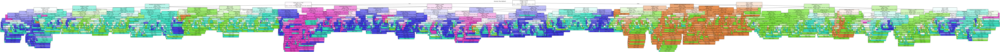

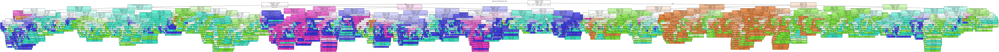

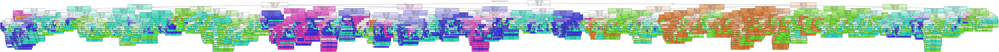

In [7]:
def plot_decision_tree(clf, feature_names=None, class_names=None, title=None):
    plt.figure(figsize=(200, 10))
    plot_tree(clf, 
              filled=True, 
              feature_names=feature_names, 
              class_names=class_names, 
              rounded=True, 
              fontsize=10)
    if title:
        plt.title(title)
    plt.show()

plot_decision_tree(dtc, feature_names=X_train.columns, class_names=True, title='Decision Tree (default)')
plot_decision_tree(optuna_dtc, feature_names=X_train.columns, class_names=True, title='Optuna Tuned Decision Tree')
plot_decision_tree(grid_dtc, feature_names=X_train.columns, class_names=True, title='GridSearch Tuned Decision Tree')


Было много попыток подбирать размерность для графиков с помощью plot_tree, но ни на одном из них так и не удалось интерпретировать модель, поэтому я использовал другой метод. Также визуально графики для optuna_dtc и grid_dtc одинаковы.

In [8]:
from graphviz import Source
from sklearn import tree

def save_tree_svg(tree_clf, file_name):
    dot_data = tree.export_graphviz(tree_clf, out_file=None,
                                    feature_names=X_train.columns,
                                    class_names=labels_y,
                                    filled=True)
    graph = Source(dot_data)
    svg_data = graph.pipe(format='svg')
    with open(f'pictures/{file_name}.svg', 'wb') as f:
        f.write(svg_data)

save_tree_svg(dtc, 'Decision Tree Classifier')
save_tree_svg(optuna_dtc, 'Decision Tree Classifier with Optuna')
save_tree_svg(grid_dtc, 'Decision Tree Classifier with GridSearch')

### Random Forest Classifier

In [9]:
rfc = RandomForestClassifier(random_state=42)
rfc.fit(X_train, y_train)
rfc_y_pred = rfc.predict(X_test)
rfc_acc = accuracy_score(y_test, rfc_y_pred) * 100
rfc_f1_macro = f1_score(y_test, rfc_y_pred, average='macro') * 100
rfc_f1_weighted = f1_score(y_test, rfc_y_pred, average='weighted') * 100
rfc_per_class = f1_score(y_test, rfc_y_pred, average=None) * 100


print(f"Accuracy: {rfc_acc:.2f}%")
print(f"F1-macro: {rfc_f1_macro:.2f}%")
print(f"F1-weighted: {rfc_f1_weighted:.2f}%")
print("F1 per class (%):", rfc_per_class)

Accuracy: 83.88%
F1-macro: 76.03%
F1-weighted: 83.56%
F1 per class (%): [65.92178771 83.39160839 88.15931109 79.10313901 63.57615894]


In [10]:
def objective(trial: optuna.Trial):
    n_estimators = trial.suggest_int('n_estimators', 50, 250)
    max_depth = trial.suggest_int('max_depth', 16, 32)
    criterion = trial.suggest_categorical('criterion', ('gini', 'entropy', 'log_loss'))

    clf = RandomForestClassifier(n_estimators=n_estimators,
                                 criterion=criterion, 
                                 max_depth=max_depth,
                                 class_weight='balanced', 
                                 random_state=42)
    
    error = cross_val_score(clf, X_train_val, y_train_val, cv=cv, scoring='f1_weighted')
    return error.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=80, n_jobs=6)

print("Best f1_weighted:", study.best_value)
print("Best params:", study.best_params)

optuna_rfc = RandomForestClassifier(**study.best_params, class_weight='balanced', random_state=42)
optuna_rfc.fit(X_train, y_train)
optuna_rfc_y_pred = optuna_rfc.predict(X_test)
optuna_rfc_acc = accuracy_score(y_test, optuna_rfc_y_pred) * 100
optuna_rfc_f1_macro = f1_score(y_test, optuna_rfc_y_pred, average='macro') * 100
optuna_rfc_f1_weighted = f1_score(y_test, optuna_rfc_y_pred, average='weighted') * 100
optuna_rfc_per_class = f1_score(y_test, optuna_rfc_y_pred, average=None) * 100


print(f"Accuracy: {optuna_rfc_acc:.2f}%")
print(f"F1-macro: {optuna_rfc_f1_macro:.2f}%")
print(f"F1-weighted: {optuna_rfc_f1_weighted:.2f}%")
print("F1 per class (%):", optuna_rfc_per_class)


Best f1_weighted: 0.8469883049926296
Best params: {'n_estimators': 245, 'max_depth': 16, 'criterion': 'log_loss'}
Accuracy: 83.56%
F1-macro: 76.27%
F1-weighted: 83.33%
F1 per class (%): [65.94594595 82.64536174 87.9049676  79.47598253 65.38461538]


In [11]:
param_grid = {
    'n_estimators': range(50, 251, 25),
    'max_depth': range(16, 33, 4),
    'criterion': ['gini', 'entropy', 'log_loss'],
}

clf = RandomForestClassifier(class_weight='balanced', random_state=42)
grid_search = GridSearchCV(estimator=clf,
                           param_grid=param_grid,
                           cv=cv,
                           scoring='f1_weighted',
                           n_jobs=6)
grid_search.fit(X_train_val, y_train_val)

print("Best f1_weighted:", grid_search.best_score_)
print("Best params:", grid_search.best_params_)

grid_rfc = grid_search.best_estimator_
grid_rfc.fit(X_train, y_train)
grid_rfc_y_pred = grid_rfc.predict(X_test)
grid_rfc_acc = accuracy_score(y_test, grid_rfc_y_pred) * 100
grid_rfc_f1_macro = f1_score(y_test, grid_rfc_y_pred, average='macro') * 100
grid_rfc_f1_weighted = f1_score(y_test, grid_rfc_y_pred, average='weighted') * 100
grid_rfc_f1_per_class = f1_score(y_test, grid_rfc_y_pred, average=None) * 100

print(f"Accuracy: {grid_rfc_acc:.2f}%")
print(f"F1-macro: {grid_rfc_f1_macro:.2f}%")
print(f"F1-weighted: {grid_rfc_f1_weighted:.2f}%")
print("F1 per class (%):", grid_rfc_f1_per_class)


Best f1_weighted: 0.8473298580715051
Best params: {'criterion': 'entropy', 'max_depth': 16, 'n_estimators': 225}
Accuracy: 83.69%
F1-macro: 76.44%
F1-weighted: 83.46%
F1 per class (%): [66.48648649 82.84444444 87.99568384 79.47598253 65.38461538]


Может показаться что в результате подбора гиперпараметров точность модели снизилась (по F1-weighted), однако если рассмотреть f1 по классам, то заметим, что точность незначительно снизилась для двух наиболее распространенных классов, но при этом для "граничных" классов точность выросла. Скорее всего это связано с использованием кросвалидации при подборе параметров.

Сравнение Optuna и GridSearch в данном случае проводилось независимо и GridSearch показал лучший результат.

Т.к. количество решателей достаточно большое, то в рамках рабботы будем отрисовывать только первые 3 дерева.

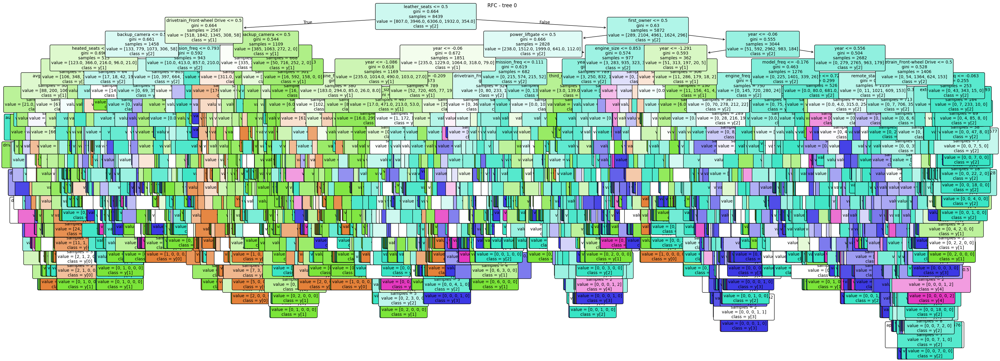

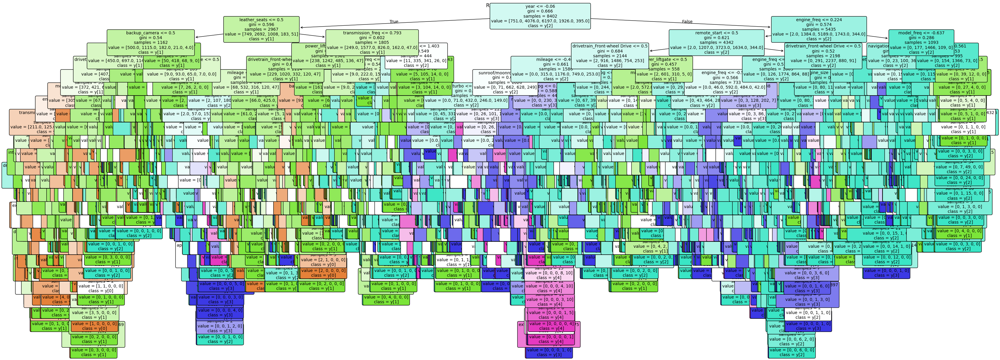

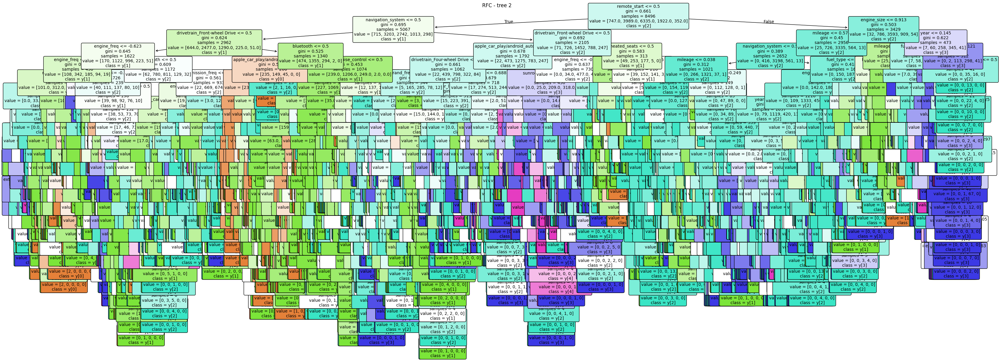

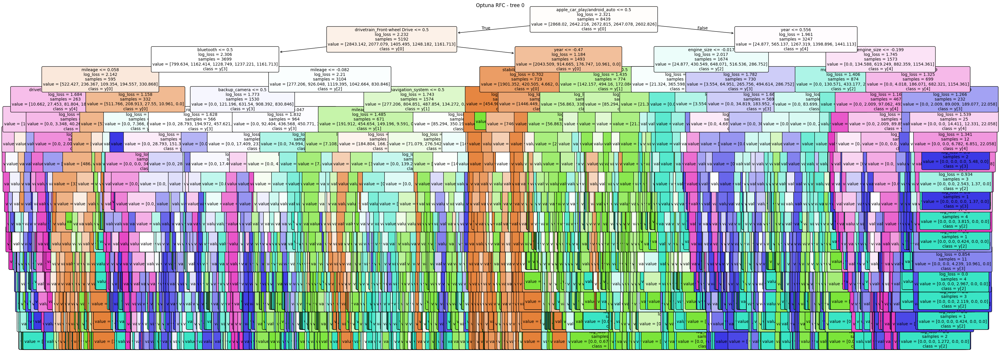

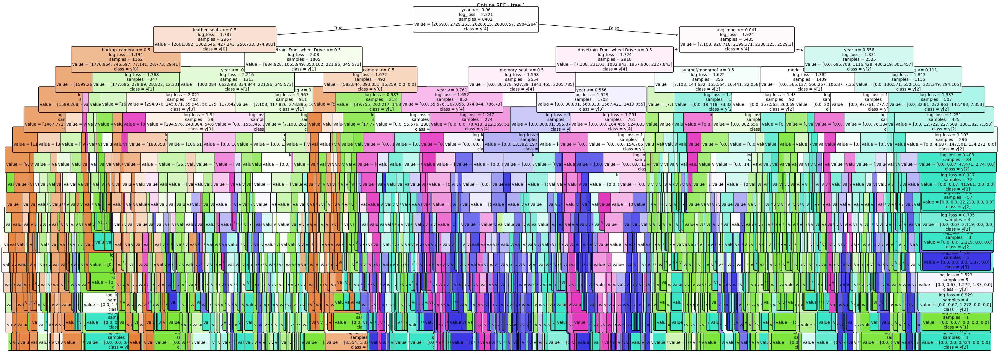

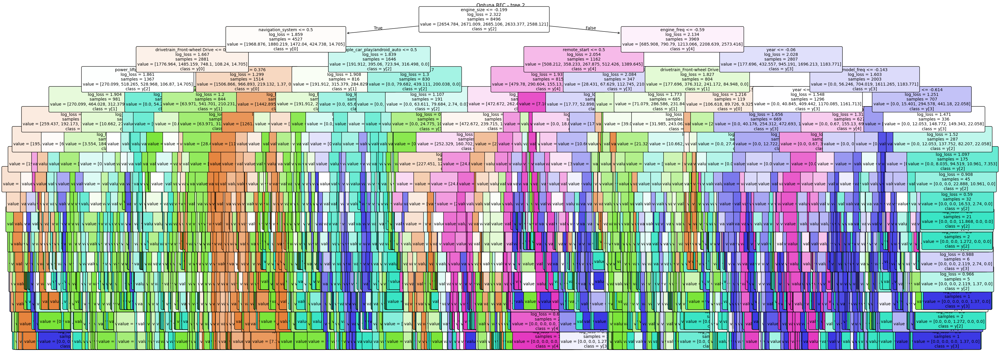

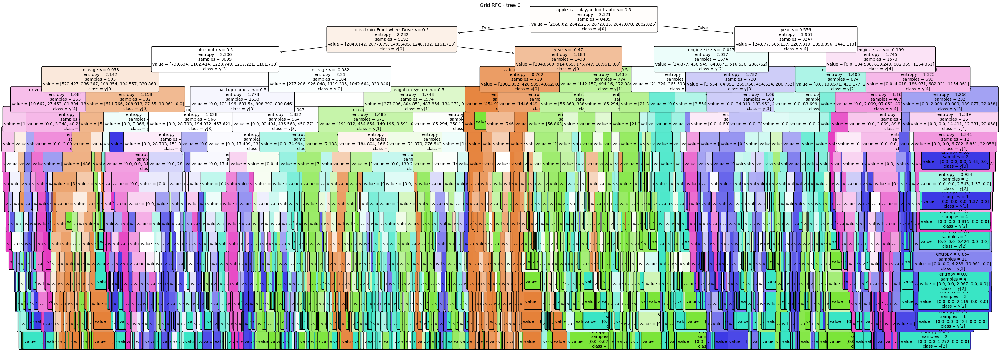

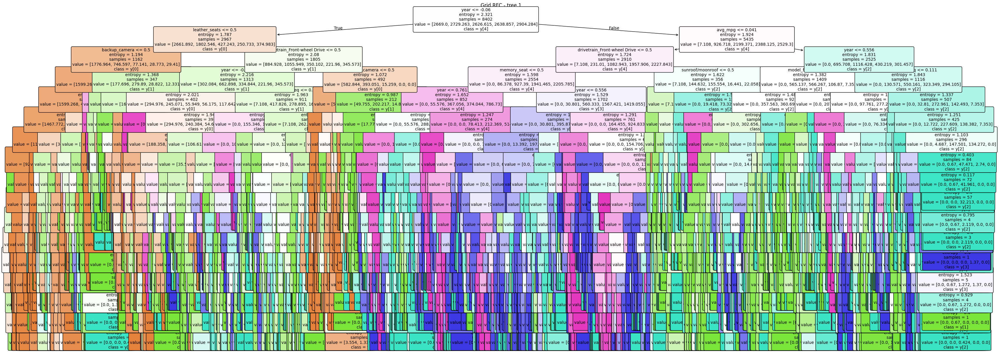

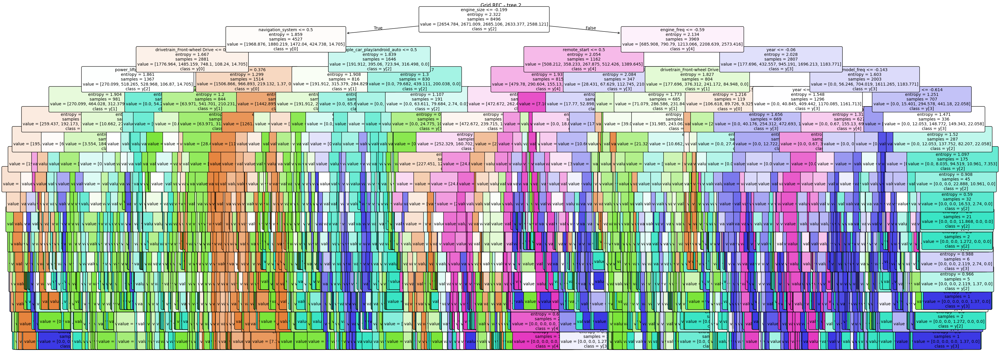

In [13]:
def plot_forest_tree(clf, tree_index, feature_names=None, class_names=None, title=None):
    dt = clf.estimators_[tree_index]
    plt.figure(figsize=(40, 15))
    plot_tree(dt,
              filled=True,
              feature_names=feature_names,
              class_names=class_names,
              rounded=True,
              fontsize=10)
    if title:
        plt.title(title)
    plt.show()

for clf, prefix in zip([rfc, optuna_rfc, grid_rfc],
                       ['RFC', 'Optuna RFC', 'Grid RFC']):
    for i in range(min(3, len(clf.estimators_))):
        plot_forest_tree(clf, i, feature_names=X_train.columns, class_names=True,
                         title=f'{prefix} - tree {i}')

In [14]:
from graphviz import Source
from sklearn import tree

def save_forest_tree_svg(rf_clf, tree_index, file_name_prefix):
    dt = rf_clf.estimators_[tree_index]
    dot_data = tree.export_graphviz(dt, out_file=None,
                                    feature_names=X_train.columns,
                                    class_names=labels_y,
                                    filled=True)
    graph = Source(dot_data)
    svg_data = graph.pipe(format='svg')
    file_name = f'pictures/{file_name_prefix}_tree_{tree_index}.svg'
    with open(file_name, 'wb') as f:
        f.write(svg_data)
    print(f'Saved {file_name}')

for clf, prefix in zip([rfc, optuna_rfc, grid_rfc],
                       ['RFC', 'Optuna_RFC', 'Grid_RFC']):
    for i in range(min(3, len(clf.estimators_))):
        save_forest_tree_svg(clf, i, prefix)


Saved pictures/RFC_tree_0.svg
Saved pictures/RFC_tree_1.svg
Saved pictures/RFC_tree_2.svg
Saved pictures/Optuna_RFC_tree_0.svg
Saved pictures/Optuna_RFC_tree_1.svg
Saved pictures/Optuna_RFC_tree_2.svg
Saved pictures/Grid_RFC_tree_0.svg
Saved pictures/Grid_RFC_tree_1.svg
Saved pictures/Grid_RFC_tree_2.svg


### Conclusion

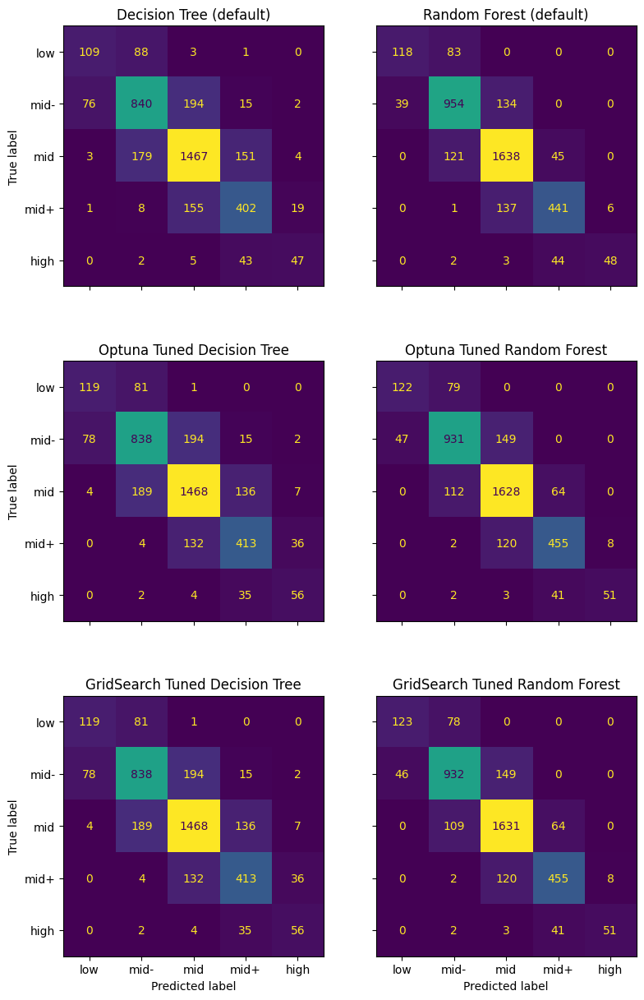

In [15]:
def plot_confusion_matrices_from_preds(y_true, preds_dtc, preds_rfc, labels, titles_left, titles_right):
    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(9, 15))

    for i, y_pred in enumerate(preds_dtc):
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
        disp.plot(ax=axes[i, 0], colorbar=False)
        axes[i, 0].set_title(titles_left[i])
    
    for i, y_pred in enumerate(preds_rfc):
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
        disp.plot(ax=axes[i, 1], colorbar=False)
        axes[i, 1].set_title(titles_right[i])
    
    for ax in axes.flat:
        ax.label_outer()
    plt.show()

preds_dtc = [dtc_y_pred, optuna_dtc_y_pred, grid_dtc_y_pred]
preds_rfc = [rfc_y_pred, optuna_rfc_y_pred, grid_rfc_y_pred]

titles_left = ['Decision Tree (default)', 'Optuna Tuned Decision Tree', 'GridSearch Tuned Decision Tree']
titles_right = ['Random Forest (default)', 'Optuna Tuned Random Forest', 'GridSearch Tuned Random Forest']

plot_confusion_matrices_from_preds(y_test, preds_dtc, preds_rfc, labels_y, titles_left, titles_right)


Видим, что использования случайного леса ожидаемо уменьшило разброс. Из тех же соображений что и в дз 2, можно сказать, что и дерево решений и случайный лес подходят для решения задачи классификации в данной задаче. Знаем что предсказание соседнего класса с настоящим допустимо, но предсказание класса через 1, уже серьезная ошибка и случайный лес таких ошибок допускает сильно меньше (почти не допускает).

Подбор гиперпараметров для решающего дерева незначительно улучшил качество, некоторые ошибки были скорректированы, но добавиились новые. Подбор гиперпараметров для случаного леса неоднозначен. С одной стороны значение метрик для "граничных" классов удалось повысить, с другой - добавилась одна ошибка (mid+ отнесли к min-). В общем случае считаю что для случайного леса модель после подбора параметров справилась лучше.

# Регрессия

In [16]:
df = pd.read_csv('data/df_after_hw_1.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19066 entries, 0 to 19065
Data columns (total 46 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   brand                         19066 non-null  object 
 1   model                         19066 non-null  object 
 2   year                          19066 non-null  float64
 3   mileage                       19066 non-null  float64
 4   engine                        19066 non-null  object 
 5   engine_size                   19066 non-null  float64
 6   transmission                  19066 non-null  object 
 7   automatic_transmission        19066 non-null  bool   
 8   fuel_type                     19066 non-null  int64  
 9   min_mpg                       19066 non-null  float64
 10  max_mpg                       19066 non-null  float64
 11  damaged                       19066 non-null  bool   
 12  first_owner                   19066 non-null  bool   
 13  p

In [17]:
data_new = df.drop(columns=['personal_using', 'automatic_emergency_braking', 'drivetrain_Unknown', 'brand', 'model', 'engine', 'transmission', 'interior_color', 'exterior_color', 'min_mpg', 'max_mpg'])

X = data_new.drop(columns=['price'])
y = data_new['price'] / 1000
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.1/0.8, random_state=42)
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

columns_to_scale = ['year', 'mileage', 'engine_size', 'avg_mpg',
                    'brand_freq', 'model_freq', 'engine_freq', 'transmission_freq',
                    'interior_color_freq', 'exterior_color_freq']

scaler = StandardScaler()
X_train[columns_to_scale] = scaler.fit_transform(X_train[columns_to_scale])
X_test[columns_to_scale] = scaler.transform(X_test[columns_to_scale])
X_train.head()

,year,mileage,engine_size,automatic_transmission,fuel_type,damaged,first_owner,turbo,alloy_wheels,adaptive_cruise_control,...,brand_freq,model_freq,engine_freq,transmission_freq,interior_color_freq,exterior_color_freq,drivetrain_Four-wheel Drive,drivetrain_Front-wheel Drive,drivetrain_Rear-wheel Drive,avg_mpg
6610,0.453054,-0.205385,-0.721192,True,5,False,True,True,True,True,...,-0.573261,-0.225248,-0.558232,0.208364,-0.933212,-0.486926,True,False,False,-0.273455
6606,0.863384,-1.167348,-0.721192,True,5,False,False,True,True,False,...,0.280332,1.256548,2.575786,-1.038874,1.153829,-0.573113,True,False,False,-0.729397
17195,-0.777936,-0.283911,-0.721192,False,5,True,False,True,True,False,...,-0.121359,0.367470,-0.580469,-1.267329,1.153829,0.563623,True,False,False,-0.820586
16205,-0.777936,-0.878428,1.184862,True,5,False,False,False,False,False,...,-0.908004,-0.719180,-0.648569,-1.285852,-0.938617,-0.575442,False,False,True,-0.328720
8665,0.453054,-0.605844,0.107527,True,5,False,True,True,True,False,...,-0.037673,-0.356964,-0.169086,1.376877,-0.941191,-0.594077,True,False,False,-0.638209


In [18]:
y_train[:10]

6610     33.799
6606     61.995
17195    35.995
16205    25.995
8665     61.393
10467    21.000
7257     48.997
6171     28.950
12611    34.455
9937     66.995
Name: price, dtype: float64

RMSE это просто корень из MSE, поэтому его проще интерпретировать. А вот справка об R2 мере:

Коэффициент детерминации, или R2 (R-квадрат), — это метрика качества регрессионной модели, которая показывает, какую часть вариации зависимой переменной модель смогла объяснить с помощью входных признаков. Говоря проще, это доля дисперсии данных, которая "поймана" моделью.

По формуле:

$$
R^2 = 1 - \frac{\sum (y_i - \hat{y}_i)^2}{\sum (y_i - \bar{y})^2}
$$

где $y_i$ — истинные значения, $\hat{y}_i$ — предсказанные моделью, $\bar{y}$ — среднее истинных значений.

- Значение R2 лежит от 0 до 1 (реже может быть отрицательным, если модель хуже среднего по данным).
- Близкое к 1 значение означает, что модель хорошо описывает данные.
- Близкое к 0 — что модель не лучше простого предсказания среднего.


In [19]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import root_mean_squared_error, r2_score

dtr = DecisionTreeRegressor(random_state=42)
dtr.fit(X_train, y_train)
dtr_y_pred = dtr.predict(X_test)
dtr_rmse = root_mean_squared_error(y_test, dtr_y_pred)
dtr_r2 = r2_score(y_test, dtr_y_pred)

print(f"Test RMSE: {dtr_rmse:.4f}")
print(f"Test R2 score: {dtr_r2:.4f}")


Test RMSE: 16.4511
Test R2 score: 0.6368


То есть в среднем такое дерево ошибается примерно на 16k$ на каждой машине. Это слишком много.

In [20]:
from sklearn.model_selection import KFold

cv = KFold(n_splits=5, shuffle=True, random_state=42)

def objective(trial: optuna.Trial):
    max_depth = trial.suggest_int('max_depth', 16, 32)
    criterion = trial.suggest_categorical('criterion', ('squared_error', 'friedman_mse', 'absolute_error', 'poisson'))
    max_features = trial.suggest_categorical('max_features', (None, 'sqrt', 'log2'))

    regressor = DecisionTreeRegressor(
        criterion=criterion, 
        max_depth=max_depth,
        max_features=max_features,
        random_state=42
    )
    error = cross_val_score(regressor, X_train_val, y_train_val, cv=cv, scoring='neg_root_mean_squared_error')
    return error.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=256, n_jobs=6)

print("Best neg RMSE:", study.best_value)
print("Best params:", study.best_params)

optuna_dtr = DecisionTreeRegressor(**study.best_params, random_state=42)
optuna_dtr.fit(X_train, y_train)

optuna_dtr_y_pred = optuna_dtr.predict(X_test)

optuna_dtr_rmse = root_mean_squared_error(y_test, optuna_dtr_y_pred)
optuna_dtr_r2 = r2_score(y_test, optuna_dtr_y_pred)

print(f"Test RMSE: {optuna_dtr_rmse:.4f}")
print(f"Test R2 score: {optuna_dtr_r2:.4f}")

Best neg RMSE: -16.495104758853113
Best params: {'max_depth': 16, 'criterion': 'poisson', 'max_features': None}
Test RMSE: 17.3603
Test R2 score: 0.5955


### Random Forest Regressor

In [21]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor(random_state=42)
rfr.fit(X_train, y_train)
rfr_y_pred = rfr.predict(X_test)
rfr_rmse = root_mean_squared_error(y_test, rfr_y_pred)
rfr_r2 = r2_score(y_test, rfr_y_pred)

print(f"Test RMSE: {rfr_rmse:.4f}")
print(f"Test R2 score: {rfr_r2:.4f}")

Test RMSE: 12.0100
Test R2 score: 0.8064


In [34]:
from sklearn.model_selection import KFold
optuna.logging.set_verbosity(optuna.logging.INFO)

cv = KFold(n_splits=5, shuffle=True, random_state=42)

def objective(trial: optuna.Trial):
    n_estimators = trial.suggest_int('n_estimators', 50, 150)
    max_depth = trial.suggest_int('max_depth', 16, 33)
    criterion = trial.suggest_categorical('criterion', ('squared_error', 'friedman_mse', 'poisson'))

    regressor = RandomForestRegressor(
        n_estimators=n_estimators,
        criterion=criterion, 
        max_depth=max_depth,
        random_state=42
    )
    error = cross_val_score(regressor, X_train_val, y_train_val, cv=cv, scoring='neg_root_mean_squared_error')
    return error.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=12, n_jobs=6)

print("Best neg RMSE:", study.best_value)
print("Best params:", study.best_params)

optuna_rfr = RandomForestRegressor(**study.best_params, random_state=42)
optuna_rfr.fit(X_train, y_train)

optuna_rfr_y_pred = optuna_rfr.predict(X_test)

optuna_rfr_rmse = root_mean_squared_error(y_test, optuna_rfr_y_pred)
optuna_rfr_r2 = r2_score(y_test, optuna_rfr_y_pred)

print(f"Test RMSE: {optuna_rfr_rmse:.4f}")
print(f"Test R2 score: {optuna_rfr_r2:.4f}")

[I 2025-10-22 02:12:58,719] A new study created in memory with name: no-name-9dd577d3-7122-43e1-9370-1b8b76f8bae2
[I 2025-10-22 02:14:28,836] Trial 3 finished with value: -11.936226388939804 and parameters: {'n_estimators': 53, 'max_depth': 28, 'criterion': 'friedman_mse'}. Best is trial 3 with value: -11.936226388939804.
[I 2025-10-22 02:15:13,483] Trial 0 finished with value: -11.84417760082523 and parameters: {'n_estimators': 74, 'max_depth': 33, 'criterion': 'friedman_mse'}. Best is trial 0 with value: -11.84417760082523.
[I 2025-10-22 02:16:11,786] Trial 5 finished with value: -11.745684155091123 and parameters: {'n_estimators': 98, 'max_depth': 18, 'criterion': 'poisson'}. Best is trial 5 with value: -11.745684155091123.
[I 2025-10-22 02:16:20,679] Trial 2 finished with value: -11.783026445053562 and parameters: {'n_estimators': 121, 'max_depth': 19, 'criterion': 'friedman_mse'}. Best is trial 5 with value: -11.745684155091123.
[I 2025-10-22 02:16:26,482] Trial 4 finished with va

Best neg RMSE: -11.745684155091123
Best params: {'n_estimators': 98, 'max_depth': 18, 'criterion': 'poisson'}
Test RMSE: 12.0593
Test R2 score: 0.8048


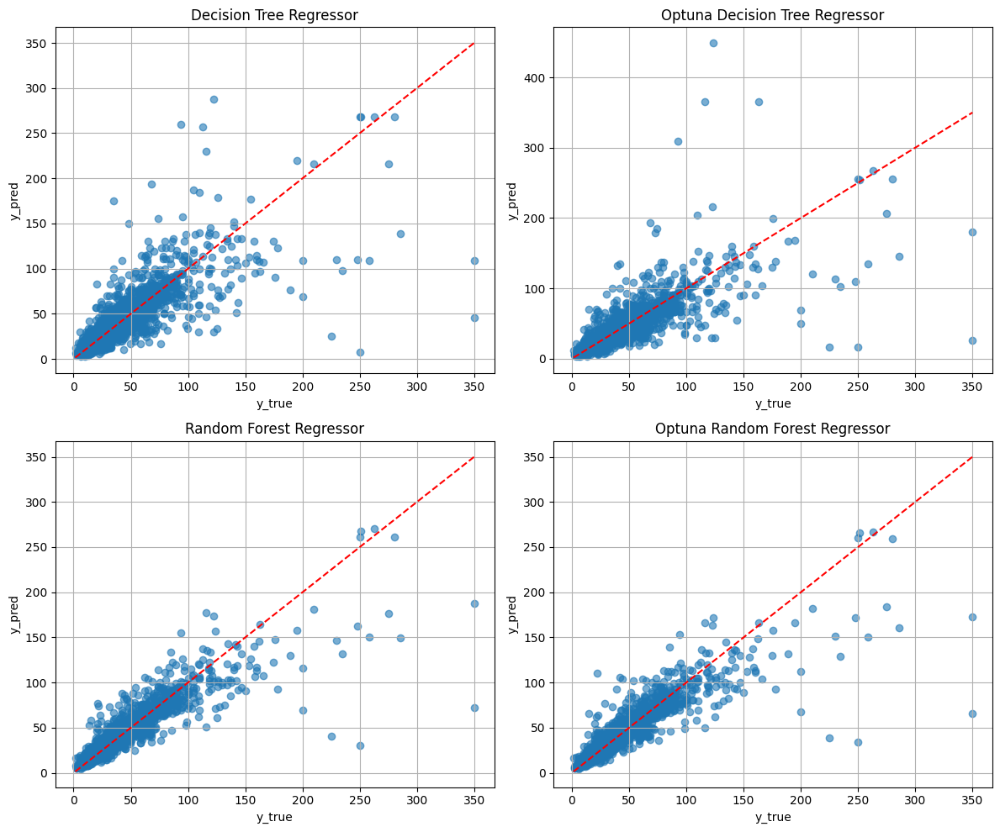

In [35]:
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, 2, figsize=(12, 10))

def plot_approximation(ax, y_true, y_pred, title):
    ax.scatter(y_true, y_pred, alpha=0.6)
    ax.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--')
    ax.set_xlabel("y_true")
    ax.set_ylabel("y_pred")
    ax.set_title(title)
    ax.grid(True)

plot_approximation(axs[0, 0], y_test, dtr_y_pred, "Decision Tree Regressor")
plot_approximation(axs[0, 1], y_test, optuna_dtr_y_pred, "Optuna Decision Tree Regressor")
plot_approximation(axs[1, 0], y_test, rfr_y_pred, "Random Forest Regressor")
plot_approximation(axs[1, 1], y_test, optuna_rfr_y_pred, "Optuna Random Forest Regressor")

plt.tight_layout()
plt.show()

Вывод: для решения задачи регрессии на данном датасете решающее дерево и случайный лес не подходят.